# Predict Churning Customers

Data Source: https://www.kaggle.com/sakshigoyal7/credit-card-customers?select=BankChurners.csv

In [250]:
import os 
import numpy as np
import pandas as pd
import seaborn as sns
import math
from scipy import stats
from sklearn.preprocessing import LabelEncoder, LabelBinarizer, MinMaxScaler
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedShuffleSplit, KFold, StratifiedKFold, cross_val_score
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
# %pylab inline


In [5]:
# load data
path = os.getcwd()
file = os.sep.join([path] + ['BankChurners.csv'])
data = pd.read_csv(file)

In [16]:
# remove last 2 columns and client number
data.drop(columns = [data.columns[0], data.columns[21], data.columns[22]], inplace = True)

In [17]:
data.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  object 
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           10127 non-null  object 
 5   Marital_Status            10127 non-null  object 
 6   Income_Category           10127 non-null  object 
 7   Card_Category             10127 non-null  object 
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Avg_Op

In [19]:
# number of numerical features and categorical features
data.dtypes.value_counts()

int64      9
object     6
float64    5
dtype: int64

## Data Cleaning and EDA

In [21]:
# Summary statistics
round(data.describe().T, 2)

,count,mean,std,min,25%,50%,75%,max
Customer_Age,10127.0,46.33,8.02,26.0,41.00,46.00,52.00,73.00
Dependent_count,10127.0,2.35,1.30,0.0,1.00,2.00,3.00,5.00
Months_on_book,10127.0,35.93,7.99,13.0,31.00,36.00,40.00,56.00
Total_Relationship_Count,10127.0,3.81,1.55,1.0,3.00,4.00,5.00,6.00
Months_Inactive_12_mon,10127.0,2.34,1.01,0.0,2.00,2.00,3.00,6.00
Contacts_Count_12_mon,10127.0,2.46,1.11,0.0,2.00,2.00,3.00,6.00
Credit_Limit,10127.0,8631.95,9088.78,1438.3,2555.00,4549.00,11067.50,34516.00
Total_Revolving_Bal,10127.0,1162.81,814.99,0.0,359.00,1276.00,1784.00,2517.00
Avg_Open_To_Buy,10127.0,7469.14,9090.69,3.0,1324.50,3474.00,9859.00,34516.00
Total_Amt_Chng_Q4_Q1,10127.0,0.76,0.22,0.0,0.63,0.74,0.86,3.40


In [23]:
data.describe(include='object').T

,count,unique,top,freq
Attrition_Flag,10127,2,Existing Customer,8500
Gender,10127,2,F,5358
Education_Level,10127,7,Graduate,3128
Marital_Status,10127,4,Married,4687
Income_Category,10127,6,Less than $40K,3561
Card_Category,10127,4,Blue,9436


### Target Variable: Attrition_Flag

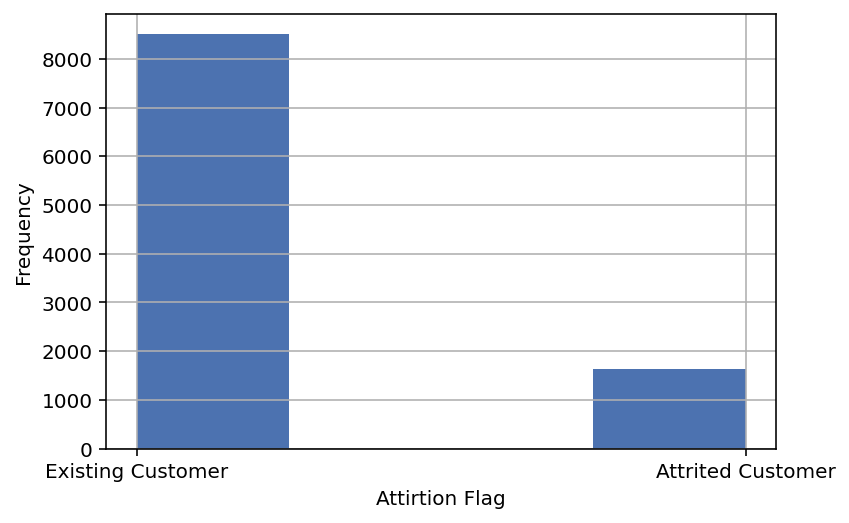

In [95]:
data['Attrition_Flag'].hist(bins = 4);
plt.xlabel('Attirtion Flag');
plt.ylabel('Frequency');
plt.savefig('target.png')

In [28]:
data['Attrition_Flag'].value_counts(normalize = True)

Existing Customer    0.83934
Attrited Customer    0.16066
Name: Attrition_Flag, dtype: float64

We are dealing with an imbalanced data set.

### Gender

In [37]:
data['Gender'].value_counts(normalize = True)

F    0.529081
M    0.470919
Name: Gender, dtype: float64

### Other Categorical Features

#### Education

In [39]:
data['Education_Level'].value_counts(normalize = True)

Graduate         0.308877
High School      0.198776
Unknown          0.149995
Uneducated       0.146835
College          0.100030
Post-Graduate    0.050953
Doctorate        0.044534
Name: Education_Level, dtype: float64

In [45]:
# combine post-graduate and doctorate into 'Above Graduate'
data['Education_Level'] = data['Education_Level'].replace(['Post-Graduate', 'Doctorate'], 'Above Graduate')

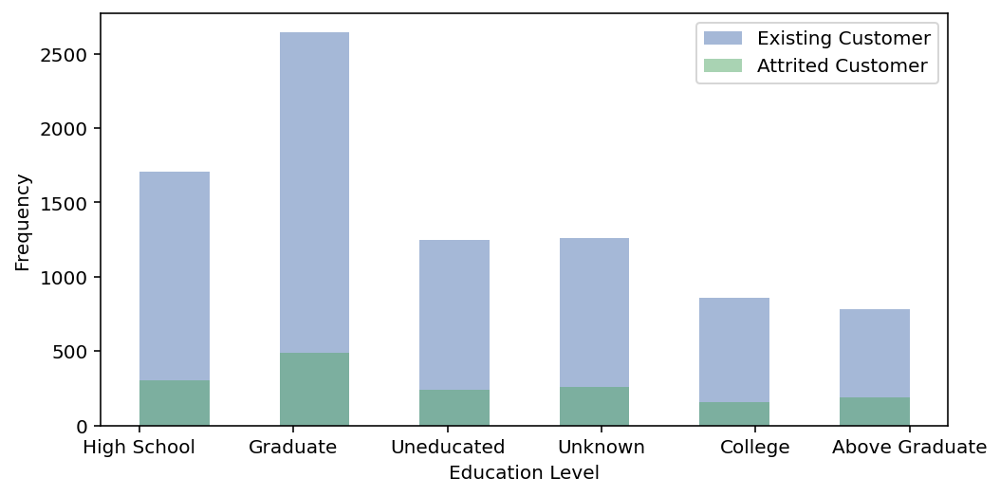

In [94]:
x = data[data['Attrition_Flag'] == 'Existing Customer']['Education_Level']
y = data[data['Attrition_Flag'] != 'Existing Customer']['Education_Level']

bins = 11
plt.style.use('seaborn-deep')
pyplot.figure(figsize = (8, 4))
pyplot.hist(x, bins, alpha=0.5, label='Existing Customer');
pyplot.hist(y, bins, alpha=0.5, label='Attrited Customer');
pyplot.legend(loc='upper right');
pyplot.xlabel('Education Level');
pyplot.ylabel('Frequency');
plt.savefig('edu.png')

#### Marital Status

In [64]:
data['Marital_Status'].value_counts(normalize = True)

Married     0.462822
Single      0.389355
Unknown     0.073961
Divorced    0.073862
Name: Marital_Status, dtype: float64

In [65]:
# replace unknow and divorced by 'Others'
data['Marital_Status'] = data['Marital_Status'].replace(['Unknown', 'Divorced'], 'Others')

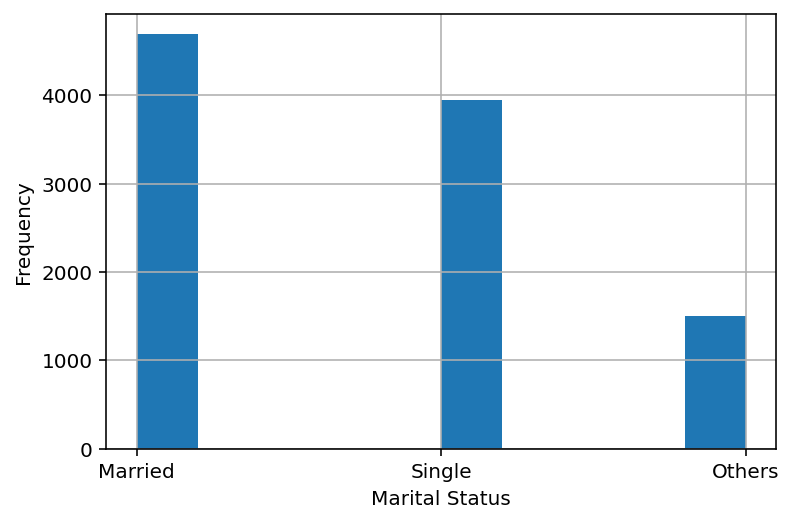

In [67]:
data['Marital_Status'].hist();
plt.xlabel('Marital Status');
plt.ylabel('Frequency');
plt.savefig('mar.png')

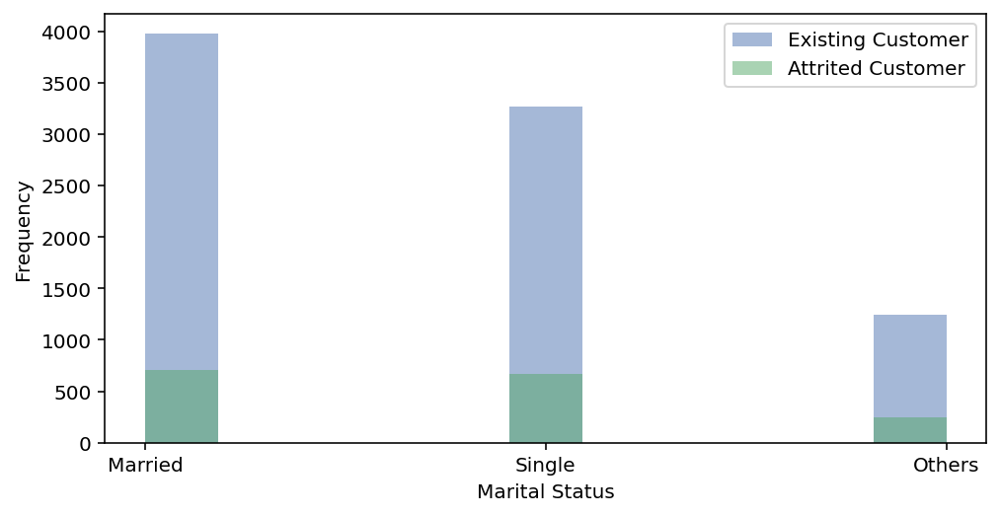

In [96]:
x = data[data['Attrition_Flag'] == 'Existing Customer']['Marital_Status']
y = data[data['Attrition_Flag'] != 'Existing Customer']['Marital_Status']

bins = 11
plt.style.use('seaborn-deep')
pyplot.figure(figsize = (8, 4))
pyplot.hist(x, bins, alpha=0.5, label='Existing Customer');
pyplot.hist(y, bins, alpha=0.5, label='Attrited Customer');
pyplot.legend(loc='upper right');
pyplot.xlabel('Marital Status');
pyplot.ylabel('Frequency');
plt.savefig('mar.png')

#### Income Category

In [68]:
data['Income_Category'].value_counts(normalize = True)

Less than $40K    0.351634
$40K - $60K       0.176755
$80K - $120K      0.151575
$60K - $80K       0.138442
Unknown           0.109805
$120K +           0.071788
Name: Income_Category, dtype: float64

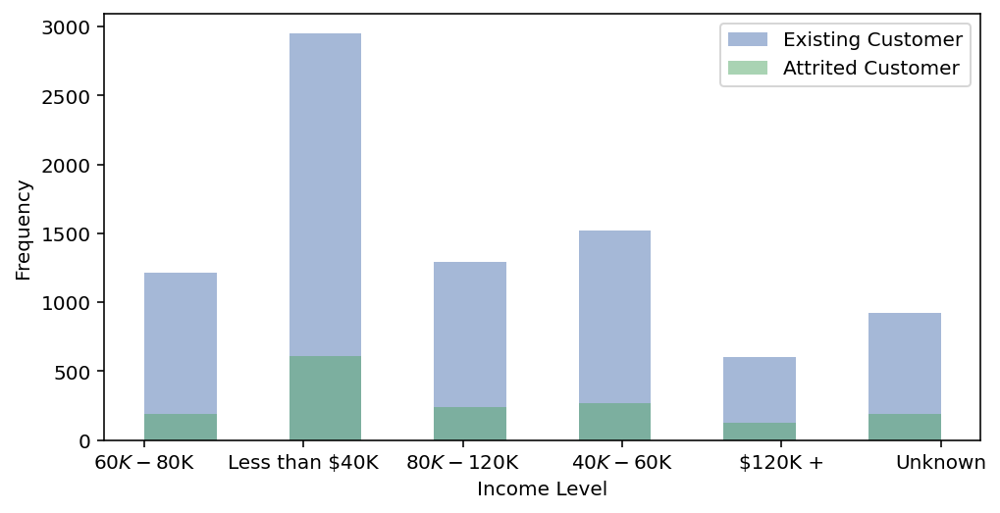

In [93]:
x = data[data['Attrition_Flag'] == 'Existing Customer']['Income_Category']
y = data[data['Attrition_Flag'] != 'Existing Customer']['Income_Category']

bins = 11
plt.style.use('seaborn-deep')
pyplot.figure(figsize = (8, 4))
pyplot.hist(x, bins, alpha=0.5, label='Existing Customer');
pyplot.hist(y, bins, alpha=0.5, label='Attrited Customer');
pyplot.legend(loc='upper right');
pyplot.xlabel('Income Level');
pyplot.ylabel('Frequency');
plt.savefig('inc.png')

#### Card Type

In [73]:
data['Card_Category'].value_counts(normalize = True)

Blue        0.931767
Silver      0.054804
Gold        0.011455
Platinum    0.001975
Name: Card_Category, dtype: float64

In [102]:
# combine gold and platinum
data['Card_Category'] = data['Card_Category'].replace(['Gold', 'Platinum', 'Silver'], 'Others')

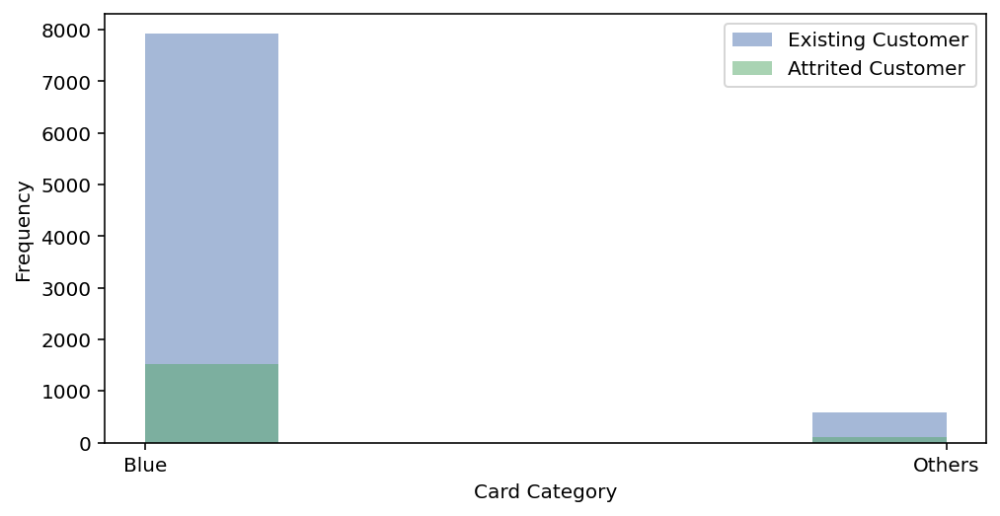

In [106]:
x = data[data['Attrition_Flag'] == 'Existing Customer']['Card_Category']
y = data[data['Attrition_Flag'] != 'Existing Customer']['Card_Category']

bins = 6
plt.style.use('seaborn-deep')
pyplot.figure(figsize = (8, 4))
pyplot.hist(x, bins, alpha=0.5, label='Existing Customer');
pyplot.hist(y, bins, alpha=0.5, label='Attrited Customer');
pyplot.legend(loc='upper right');
pyplot.xlabel('Card Category');
pyplot.ylabel('Frequency');
plt.savefig('card.png')

### Numerical Variables

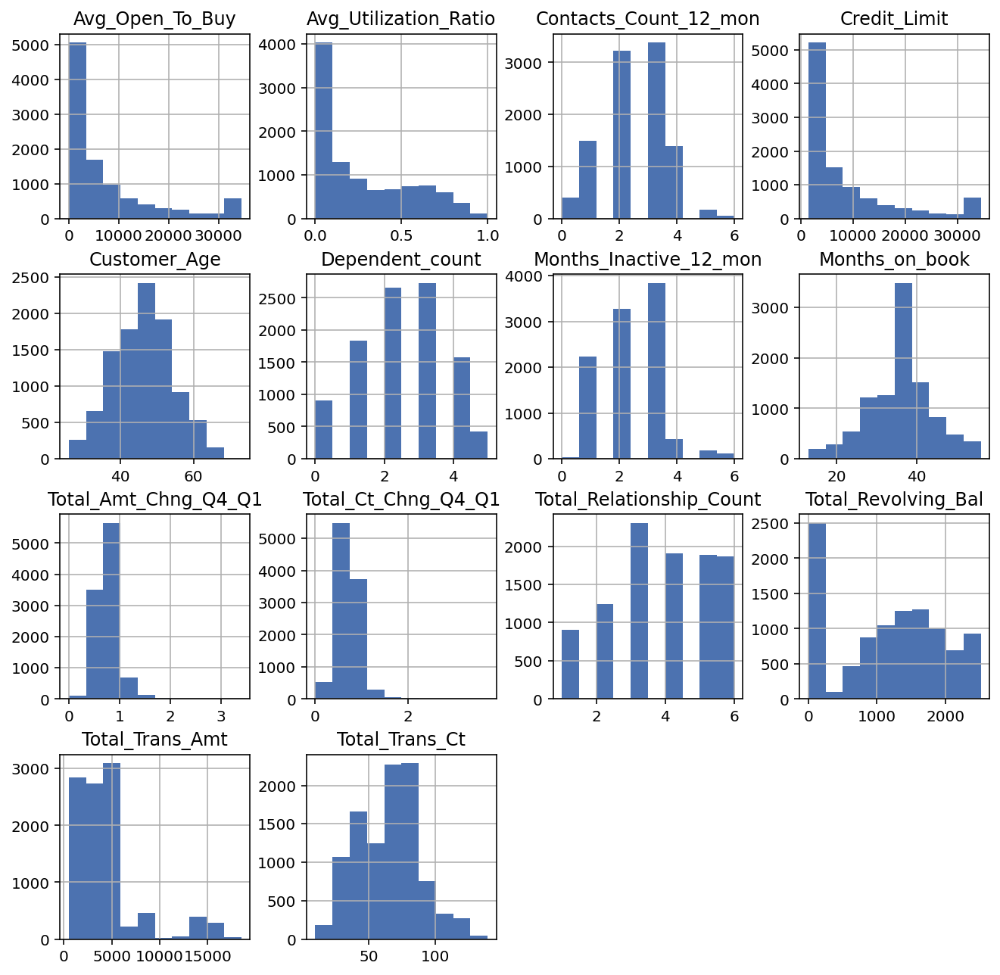

In [110]:
data.hist(figsize = (11, 11));
plt.savefig('hist.png')

In [113]:
# log transformation monetary values
log_cols = ['Avg_Open_To_Buy', 'Credit_Limit', 'Total_Revolving_Bal', 'Total_Trans_Amt']
for col in log_cols:
    data[col] = data[col].apply(np.log1p)

In [116]:
# identify outliers
def bounds(x):
    '''
    This funciton finds the lower and upper bounds for outliers in an array using the
    1.5IQR rule
    Input: x(array)
    Output: IQR, lower bound, upper bound
    '''
    q1 = np.quantile(x, 0.25)
    q3 = np.quantile(x, 0.75)
    iqr = q3 - q1
    # finding upper and lower whiskers
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    
    return [lower, upper]

In [124]:
# remove observations outside the bounds
tmc = data['Total_Amt_Chng_Q4_Q1']
tmc_lo, tmc_up = bounds(tmc)
tcc = data['Total_Ct_Chng_Q4_Q1']
tcc_lo, tcc_up = bounds(tcc)
data = data[data['Total_Amt_Chng_Q4_Q1'] >= tmc_lo]
data = data[data['Total_Amt_Chng_Q4_Q1'] <= tmc_up]
data = data[data['Total_Ct_Chng_Q4_Q1'] >= tcc_lo]
data = data[data['Total_Ct_Chng_Q4_Q1'] <= tcc_up]

In [125]:
data.shape

(9318, 20)

In [126]:
# the ratio between two labels does not change significantly
data['Attrition_Flag'].value_counts(normalize = True)

Existing Customer    0.83988
Attrited Customer    0.16012
Name: Attrition_Flag, dtype: float64

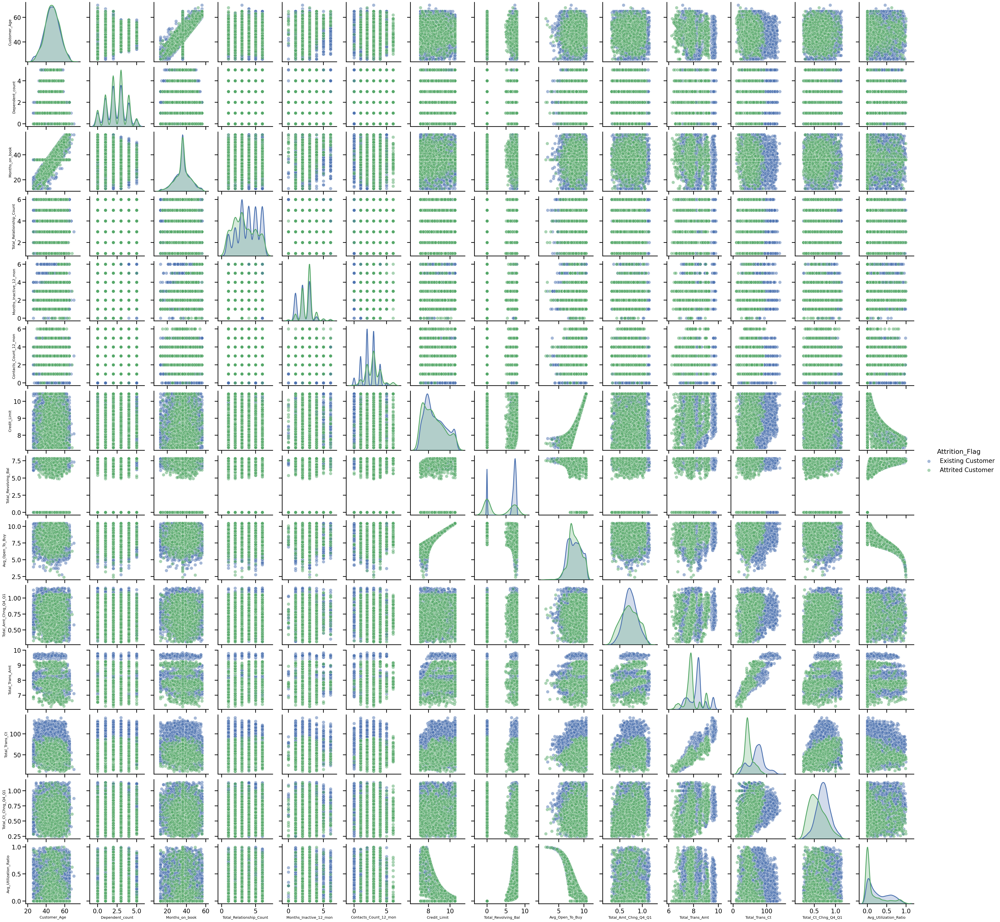

In [135]:
# pairplot
numcol = data.columns[data.dtypes != 'object'].tolist()
sns.set_context("talk", rc={"axes.labelsize":10})
sns.pairplot(data[numcol], hue='Attrition_Flag', plot_kws = {'alpha': 0.5});
plt.savefig('pair.png')

## Feature Engineering

### One-hot Encoding

In [138]:
# encode target variable
lb = LabelBinarizer()
data['Attrition_Flag'] = lb.fit_transform(data['Attrition_Flag'])

In [139]:
data['Attrition_Flag'].value_counts(normalize = True)

1    0.83988
0    0.16012
Name: Attrition_Flag, dtype: float64

In [154]:
# encode other categorical features
cat_cols = data.columns[data.dtypes == 'object'].tolist()
X = pd.get_dummies(data, columns = cat_cols, drop_first = True)

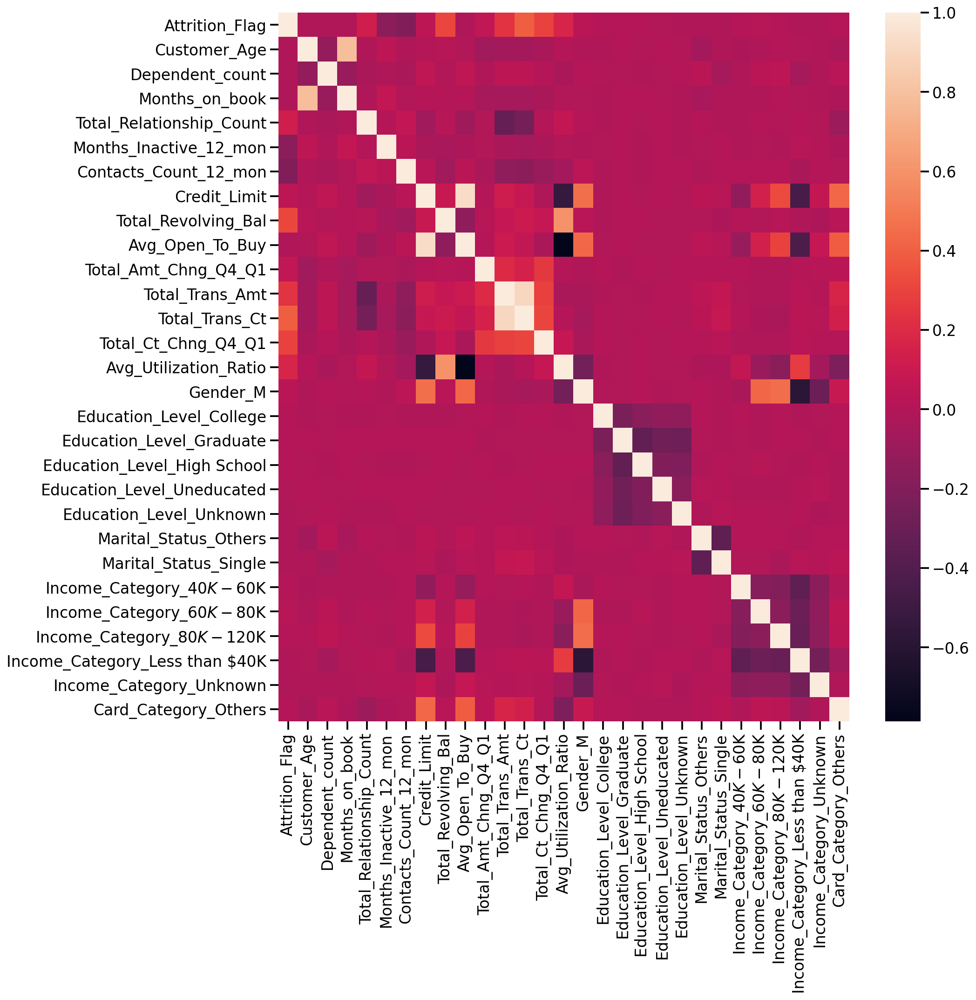

In [151]:
# heatmap to see correlations
corr = X.corr(method='pearson')
plt.figure(figsize=(15,15))
sns.heatmap(corr);
plt.tight_layout()
plt.savefig('heat.png')

In [156]:
# drop gender and average open to buy since they correlated with other features and do not affect 
# distribution of attrited/existing customers
X.drop(columns = ['Gender_M', 'Avg_Open_To_Buy'], inplace = True)

In [158]:
X.shape

(9318, 27)

## Training Models

### Prepare the data

In [159]:
# separate target and features
y = X['Attrition_Flag']
X.drop(columns = ['Attrition_Flag'], inplace = True)

In [168]:
# stratified split
sp = StratifiedShuffleSplit(n_splits = 1, test_size = 0.3, random_state = 595)
train, test = next(sp.split(X, y))
# get training and testing data
X_train = X.iloc[train, :]
X_test = X.iloc[test, :]
y_train = y.iloc[train]
y_test = y.iloc[test]

In [169]:
y_train.value_counts(normalize = True)

1    0.839926
0    0.160074
Name: Attrition_Flag, dtype: float64

In [170]:
y_test.value_counts(normalize = True)

1    0.839771
0    0.160229
Name: Attrition_Flag, dtype: float64

In [173]:
# scale the features
s = MinMaxScaler()
X_train = s.fit_transform(X_train)
X_test = s.transform(X_test)

In [175]:
# over-sampling the minority class in the training data
Xr_train, yr_train = SMOTE().fit_resample(X_train, y_train)

In [177]:
yr_train.value_counts(normalize = True)

1    0.5
0    0.5
Name: Attrition_Flag, dtype: float64

In [220]:
# cross validation
kv = StratifiedKFold(n_splits = 3, shuffle = True, random_state = 45)

### Logistic Regression

In [245]:
lr = LogisticRegressionCV(Cs = 10, cv = kv, penalty = 'l2', solver = 'liblinear')
lr.fit(Xr_train, yr_train)

LogisticRegressionCV(cv=StratifiedKFold(n_splits=3, random_state=45, shuffle=True),
                     solver='liblinear')

In [280]:
# predict
ypred_lr = lr.predict(X_test)

In [281]:
# compute metrics
precision, recall, fscore, _ = score(y_test, ypred_lr, average = 'weighted')
cm_lr = confusion_matrix(y_test, ypred_lr)
result_lr = pd.Series({'Precision': precision, 'Recall': recall, 'Fscore': fscore}, name = 'Logistic')

In [303]:
# look at the coefficients for each feature
coef = pd.DataFrame(data = {'Features': X.columns.tolist(), 'Coefficient': lr.coef_[0]} )
coef['Abs_Coef'] = coef['Coefficient'].apply(np.abs)
coef.sort_values(by = ['Abs_Coef'], ascending = False, inplace = True)

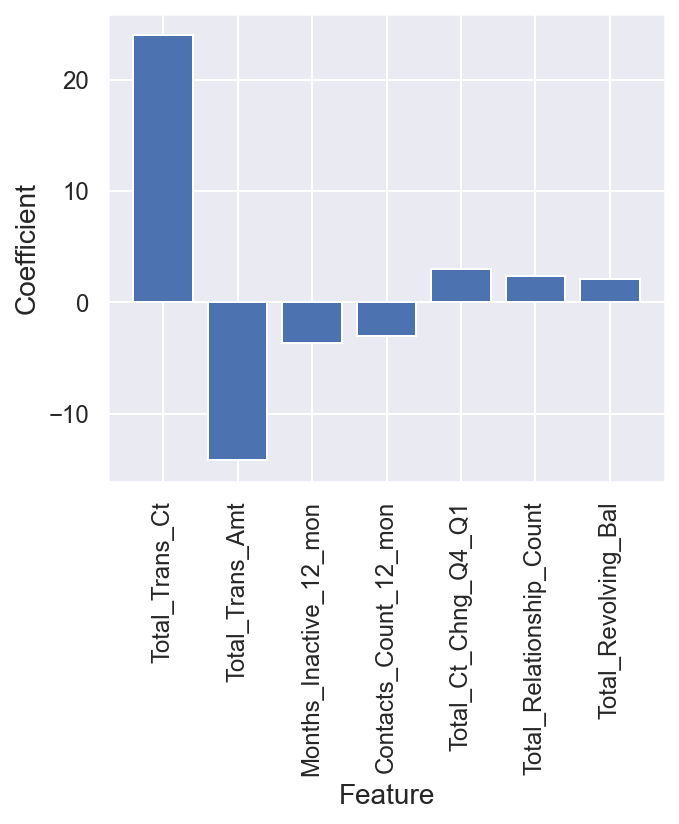

In [353]:
# plot coefficients
figure(figsize=(5,6))
f = plt.bar(coef[coef.Abs_Coef > 1].Features, coef[coef.Abs_Coef > 1].Coefficient);
plt.xticks(rotation = 90, fontsize=12);
plt.yticks(rotation = 0, fontsize=12);
plt.tight_layout();
plt.xlabel('Feature', fontsize = 14)
plt.ylabel('Coefficient', fontsize = 14)
plt.savefig('coefs.png')

In [309]:
coef

,Features,Coefficient,Abs_Coef
10,Total_Trans_Ct,24.004621,24.004621
9,Total_Trans_Amt,-14.209634,14.209634
4,Months_Inactive_12_mon,-3.688098,3.688098
5,Contacts_Count_12_mon,-3.029518,3.029518
11,Total_Ct_Chng_Q4_Q1,2.971987,2.971987
3,Total_Relationship_Count,2.363548,2.363548
7,Total_Revolving_Bal,2.098006,2.098006
1,Dependent_count,-0.825708,0.825708
2,Months_on_book,0.760970,0.760970
14,Education_Level_Graduate,0.550016,0.550016


#### Using the oversampled training set

In [282]:
result_lr

Precision    0.904751
Recall       0.868383
Fscore       0.878921
Name: Logistic, dtype: float64

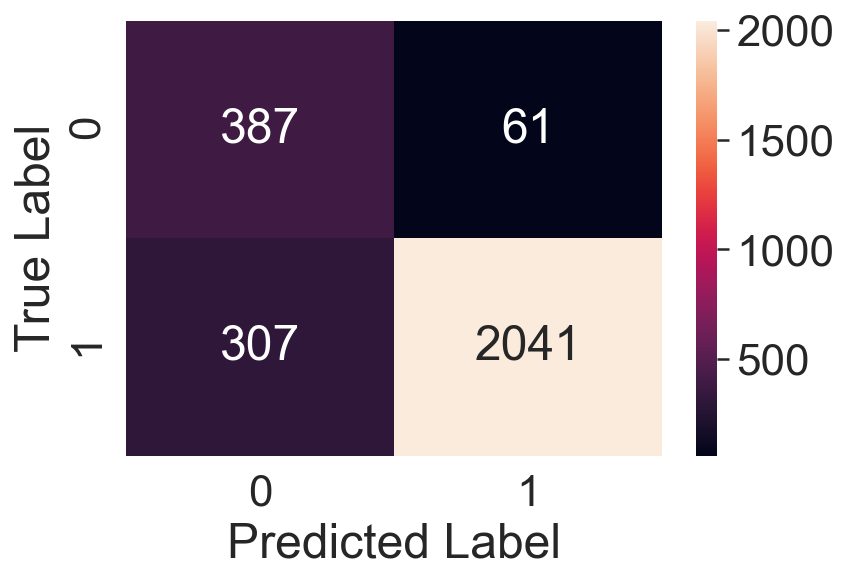

In [283]:
# confusion matrix
sns.set(font_scale=2)
sns.heatmap(cm_lr, annot = True, fmt = 'd');
plt.xlabel('Predicted Label');
plt.ylabel('True Label');

#### Using original training set

In [224]:
result_lr

Precision    0.907125
Recall       0.911660
Fscore       0.908119
Name: Logistic, dtype: float64

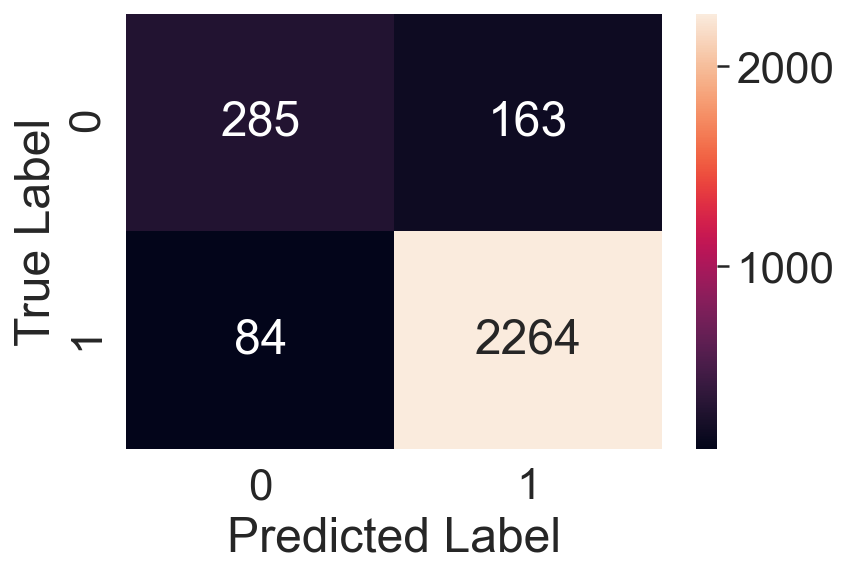

In [225]:
# confusion matrix
sns.set(font_scale=2)
sns.heatmap(cm_lr, annot = True, fmt = 'd');
plt.xlabel('Predicted Label');
plt.ylabel('True Label');

For business purpose, we want to minimize Type I error, since missing churning customer will do more harm than mis-classified existing customer as churning customer. 
Thus we will use over-sampled dataset for training.

### Linear SVM

In [243]:
# use cross validation to tune parameter C
clf_svm = svm.SVC(kernel = 'linear')
C_s = [0.1, 1, 10]
scores = list()
for c in C_s:
    clf_svm.C = c
    s = cross_val_score(clf_svm, Xr_train, yr_train, cv = kv, scoring = 'f1')
    scores.append(np.mean(s))

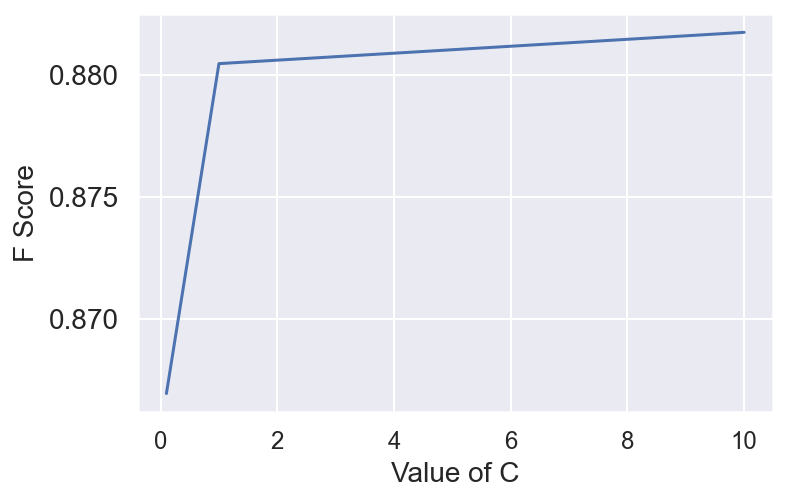

In [357]:
# plot scores
plt.plot(C_s, scores);
plt.xlabel('Value of C', fontsize = 14);
plt.ylabel('F Score', fontsize = 14);
plt.yticks(fontsize = 14)
plt.tight_layout();
plt.savefig('svm_param.png');

In [284]:
# Choose C = 1 on the whole training set
clf_svc = svm.SVC(kernel = 'linear', C = 1)
clf_svc.fit(Xr_train, yr_train)
ypre_svm = clf_svc.predict(X_test)

In [361]:
# look at coefficients
coef_svm = pd.DataFrame(data = {'Features': X.columns.tolist(), 'Coefficient': clf_svc.coef_[0]} )
coef_svm['Abs_Coef'] = coef_svm['Coefficient'].apply(np.abs)
coef_svm.sort_values(by = ['Abs_Coef'], ascending = False, inplace = True)

In [364]:
coef_svm[coef_svm.Abs_Coef > 1]

,Features,Coefficient,Abs_Coef
10,Total_Trans_Ct,15.645347,15.645347
9,Total_Trans_Amt,-9.139311,9.139311
4,Months_Inactive_12_mon,-2.492016,2.492016
11,Total_Ct_Chng_Q4_Q1,2.048462,2.048462
5,Contacts_Count_12_mon,-1.871008,1.871008
3,Total_Relationship_Count,1.404781,1.404781
7,Total_Revolving_Bal,1.285014,1.285014


In [285]:
# compute metrics
precision, recall, fscore, _ = score(y_test, ypre_svm, average = 'weighted')
cm_svm = confusion_matrix(y_test, ypre_svm)
result_svm = pd.Series({'Precision': precision, 'Recall': recall, 'Fscore': fscore}, name = 'Linear SVM')
result_svm

Precision    0.906510
Recall       0.868383
Fscore       0.879213
Name: Linear SVM, dtype: float64

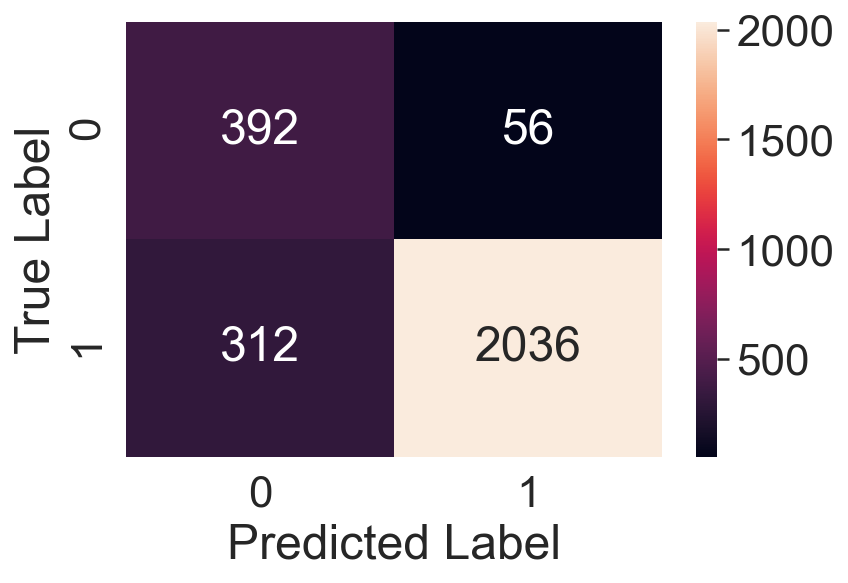

In [286]:
# confusion matrix
sns.set(font_scale=2)
sns.heatmap(cm_svm, annot = True, fmt = 'd');
plt.xlabel('Predicted Label');
plt.ylabel('True Label');

### KNN

In [287]:
N = [2, 3, 5, 7]
scores_knn = list()
for n in N:
    clf_knn = KNeighborsClassifier(n_neighbors = n)
    s = cross_val_score(clf_knn, Xr_train, yr_train, cv = kv, scoring = 'f1')
    scores_knn.append(np.mean(s))

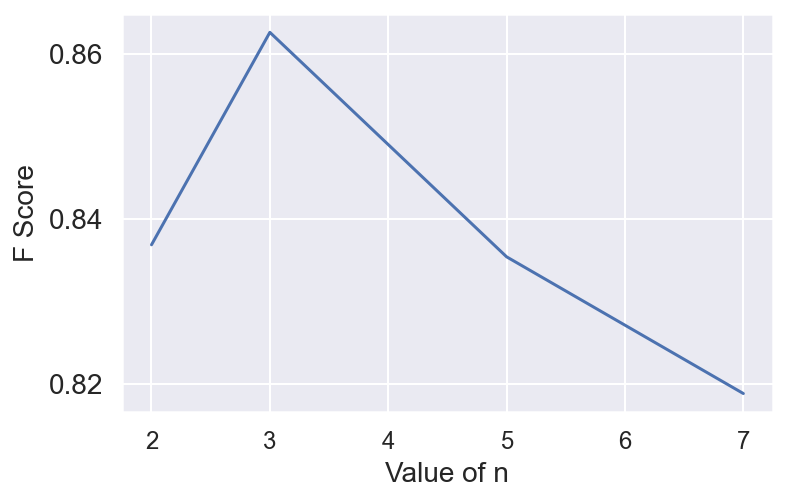

In [359]:
# plot scores
plt.plot(N, scores_knn);
plt.xlabel('Value of n', fontsize = 14);
plt.ylabel('F Score', fontsize = 14);
plt.yticks(fontsize = 14)
plt.tight_layout()
plt.savefig('knn_param.png')

In [289]:
# n = 3
knn = KNeighborsClassifier(n_neighbors = 3)
knn.fit(Xr_train, yr_train)
pred_knn = knn.predict(X_test)

In [290]:
# compute metrics
precision, recall, fscore, _ = score(y_test, pred_knn, average = 'weighted')
cm_knn = confusion_matrix(y_test, pred_knn)
result_knn = pd.Series({'Precision': precision, 'Recall': recall, 'Fscore': fscore}, name = 'KNN')
result_knn

Precision    0.827598
Recall       0.780401
Fscore       0.798081
Name: KNN, dtype: float64

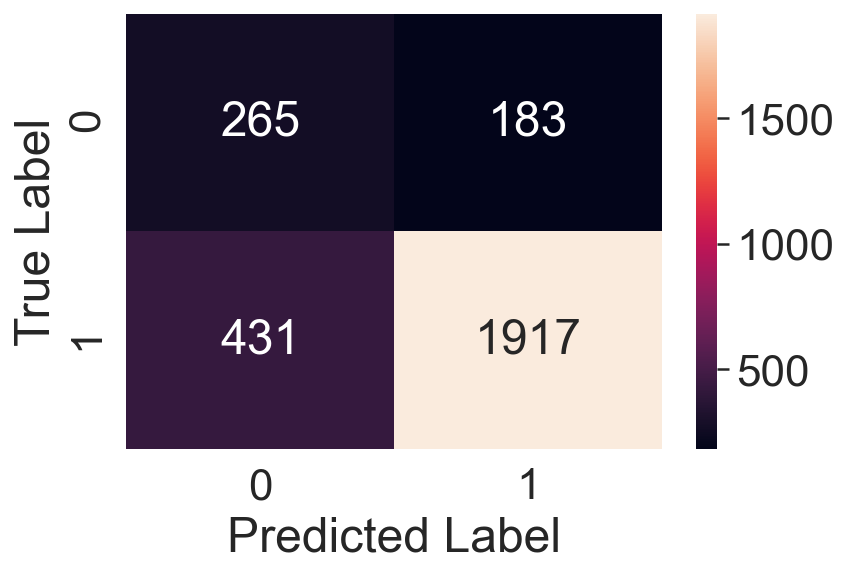

In [291]:
# confusion matrix
sns.set(font_scale=2)
sns.heatmap(cm_knn, annot = True, fmt = 'd');
plt.xlabel('Predicted Label');
plt.ylabel('True Label');